# Dimensionality reduction: PCA 

Load Libraries

In [27]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler # to scale data for PCA
from sklearn.decomposition import PCA # the actual PCA
%matplotlib inline

Dataset

In [2]:
from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()
print(cancer['DESCR'])

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

:Number of Instances: 569

:Number of Attributes: 30 numeric, predictive attributes and the class

:Attribute Information:
    - radius (mean of distances from center to points on the perimeter)
    - texture (standard deviation of gray-scale values)
    - perimeter
    - area
    - smoothness (local variation in radius lengths)
    - compactness (perimeter^2 / area - 1.0)
    - concavity (severity of concave portions of the contour)
    - concave points (number of concave portions of the contour)
    - symmetry
    - fractal dimension ("coastline approximation" - 1)

    The mean, standard error, and "worst" or largest (mean of the three
    worst/largest values) of these features were computed for each image,
    resulting in 30 features.  For instance, field 0 is Mean Radius, field
    10 is Radius SE, field 20 is Worst Radius.

    - 

In [3]:
df = pd.DataFrame(cancer['data'],columns=cancer['feature_names'])
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [39]:
# Add target labels
df_with_target = df.copy()
df_with_target['target'] = cancer['target']
df_with_target['target'] = df_with_target['target'].map({0: 'Malignant', 1: 'Benign'})

# Create pairplot
sns.pairplot(df_with_target, hue='target', diag_kind='kde')


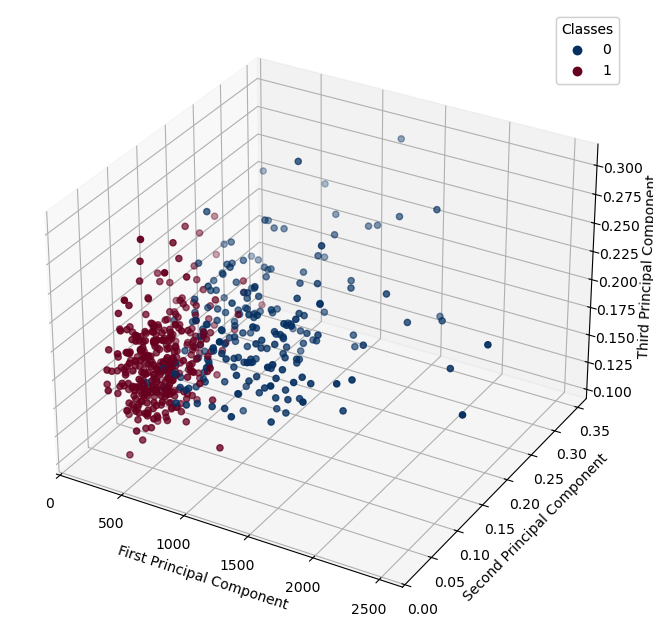

In [36]:

# Create a 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(df['mean area'], df['mean compactness'], df['mean symmetry'], c=cancer['target'], cmap='RdBu_r')

# Add labels
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')
ax.set_zlabel('Third Principal Component')

# Add legend
legend = ax.legend(*scatter.legend_elements(), title="Classes")
ax.add_artist(legend)

# Show plot
plt.show()


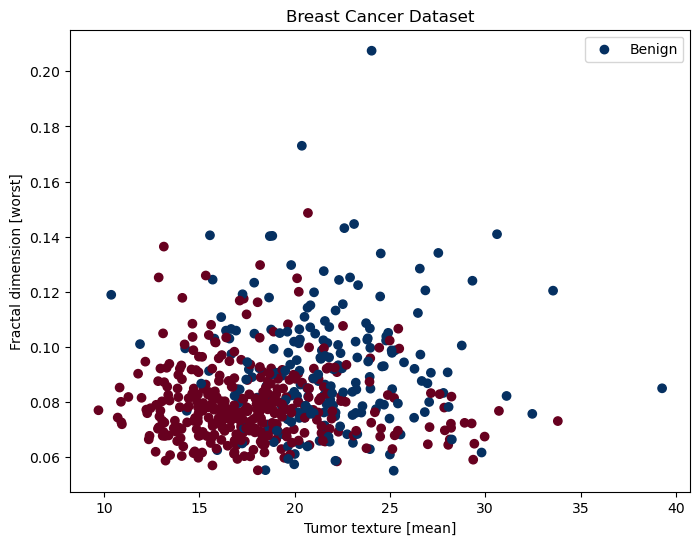

In [42]:
plt.figure(figsize=(8,6))
plt.scatter(df['mean texture'], df['worst fractal dimension'],c=cancer['target'],cmap='RdBu_r')
plt.xlabel('Tumor texture [mean]')
plt.ylabel('Fractal dimension [worst]') 
plt.title('Breast Cancer Dataset')
plt.legend(['Benign', 'Malignant'], loc='upper right')
plt.show()

The following lines of code instantiate a PCA object, find the principal components using the fit method, then apply the rotation and dimensionality reduction by calling transform().

You can also specify how many components you want to keep when creating the PCA object.

In [7]:
# 1. Standardize the data
scaler = StandardScaler()
scaler.fit(df)
scaled_data = scaler.transform(df)
# 2 fit the PCA method
n_components = 4
pca = PCA(n_components=n_components)
pca.fit(scaled_data)
# transform this data to its first n_components principal components.
pca_res = pca.transform(scaled_data)

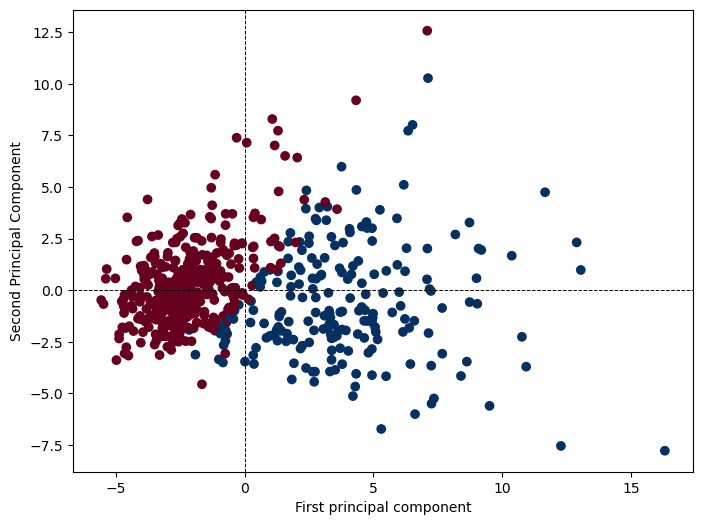

In [44]:
plt.figure(figsize=(8,6))
plt.scatter(pca_res[:,0],pca_res[:,1],c=cancer['target'],cmap='RdBu_r')
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')
plt.axhline(0, color='black', linestyle='--', linewidth=0.7)
plt.axvline(0, color='black', linestyle='--', linewidth=0.7)
#plt.legend(['Benign', 'Malignant'], loc='upper right')
plt.show()
